In [1]:
import pandas as pd
import os
from itertools import combinations
import networkx as nx
import matplotlib.pyplot as plt

In [2]:
proj_dir = '../human_disease/network_propagation'

In [3]:
def make_fset(x, drop=True):
    if len(set(x.split(' '))) < 2:
        print(f"WARNING: Features for '{x}-{x}' (self-self PPI) detected ...")
        if drop == False:
            x1 = x.split(' ')[0]
            fset = frozenset({x1,x1})
            return(fset)
        else:
            return(None)
    else:
        x1 = x.split(' ')[0]
        x2 = x.split(' ')[1]
        fset = frozenset({x1,x2})
        return(fset)
    
def fmt_gene_name(gene_list):
    n_genes = gene_list.split(',')
    if 'NA' in n_genes:
        n_genes.remove('NA')
    if len(n_genes) > 3:
        gene = ',\n'.join(n_genes[0:2]) + ' ...'
    else:
        gene = ','.join(n_genes)
    return(gene)

def get_geneid_dict(df, i):
    inputs = df['input_nogs'][i].split(';')
    genes = df['gene_names'][i].split(';')
    genes = [fmt_gene_name(x) for x in genes]
    inputs_id_dict = dict(zip(inputs, genes))
    return(inputs_id_dict)

def map_id(x, dict1, dict2):
    try: 
        gene = dict1[x]
    except KeyError:
        try:
            gene = dict2[x]
        except:
            print(f'Error: no gene ID found for {x}')
            gene = x
    return(gene)

In [32]:
ppi_nx_file = f'{proj_dir}/data/leca_map.csv'
dis_nx_file = f'{proj_dir}/data/disease_network.tsv'
res_file = f'{proj_dir}/results/leca_diseases_leave1out_auroc_top20_w-fu.csv'
annot_file = f'{proj_dir}/results/top20_hits_annotated_w-fu.csv'

In [33]:
ppi_nx = pd.read_csv(ppi_nx_file)
res = pd.read_csv(res_file)
top_annots = pd.read_csv(annot_file)

In [6]:
bbs = res[res['disease'] == 'Bardet-Biedl syndrome']
bbs['top_hits'].to_list()

['KOG3679;ENOG502QS2X;KOG1242;ENOG502QPS5;KOG0531;KOG0078;KOG3616;KOG3647;KOG0364;KOG0363;KOG0358;KOG0361;KOG0359;KOG0362;KOG3170;KOG1672;KOG0211;KOG3501;KOG2004;KOG2830']

In [34]:
cands_id_dict = dict()
for i in range(len(top_annots)):
    nog = top_annots['top_hits'][i]
    gene = top_annots['human_gene_names_primary'][i]
    n_genes = gene.split(', ')
    if 'NA' in n_genes:
        n_genes.remove('NA')
    if len(n_genes) > 3:
        gene = ',\n'.join(n_genes[0:2]) + ' ...'
    cands_id_dict[nog] = gene
cands_id_dict['KOG2177']

'FSD2,\nTRIM43B ...'

In [8]:
dark_purple = "#5530AA"
med_purple = "#3C5488"
light_purple = "#8491B4"
reds = ["#7D0112", "#A14C26", "#C17F45"]

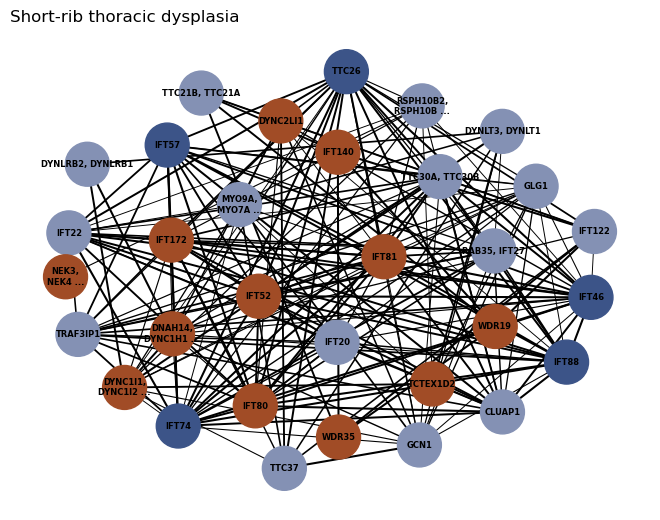

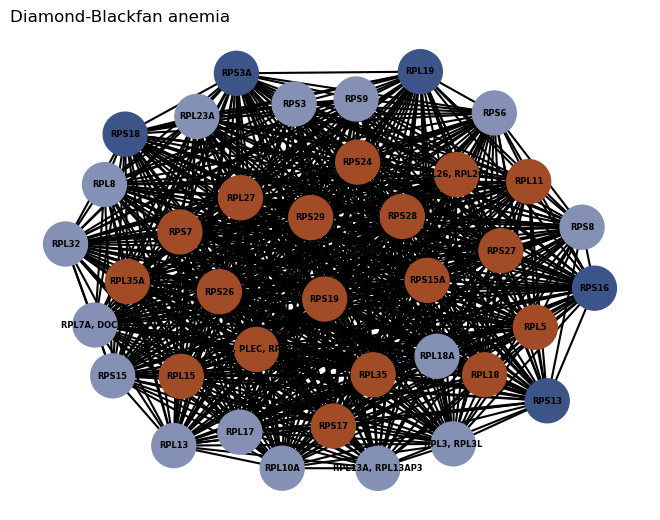

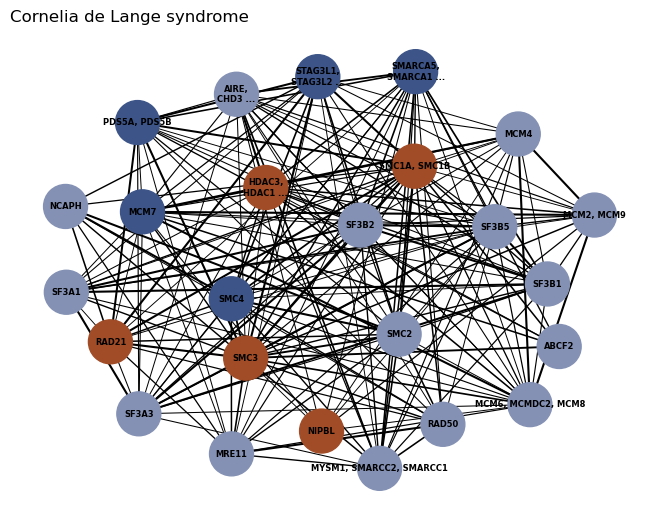

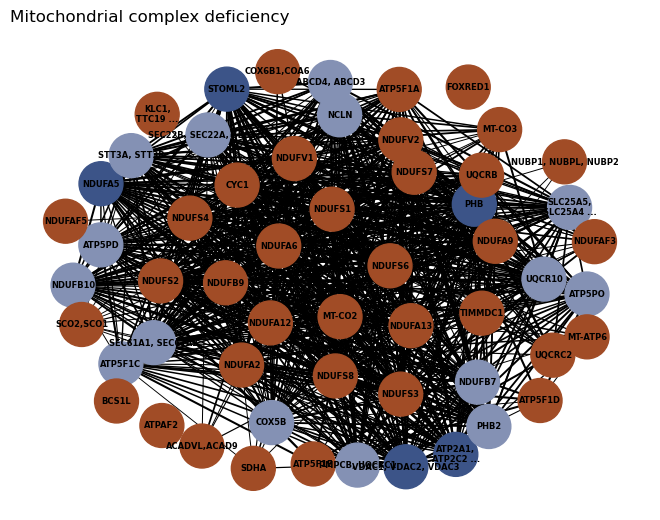

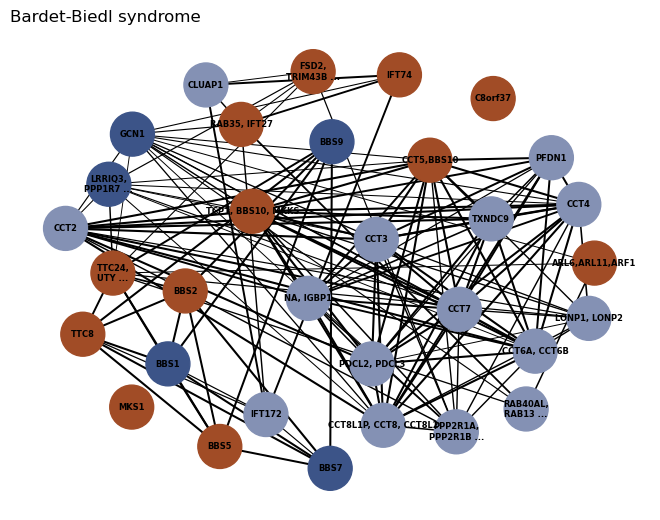

...

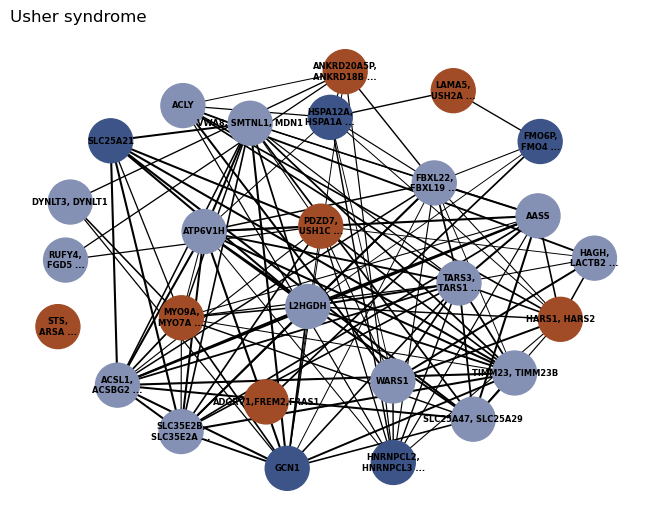

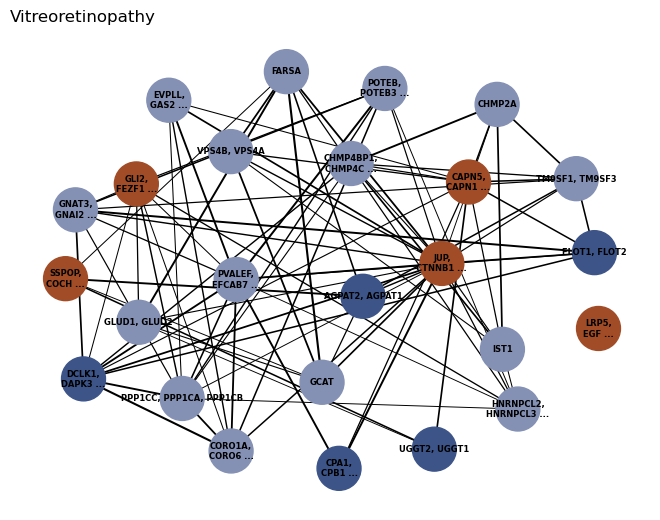

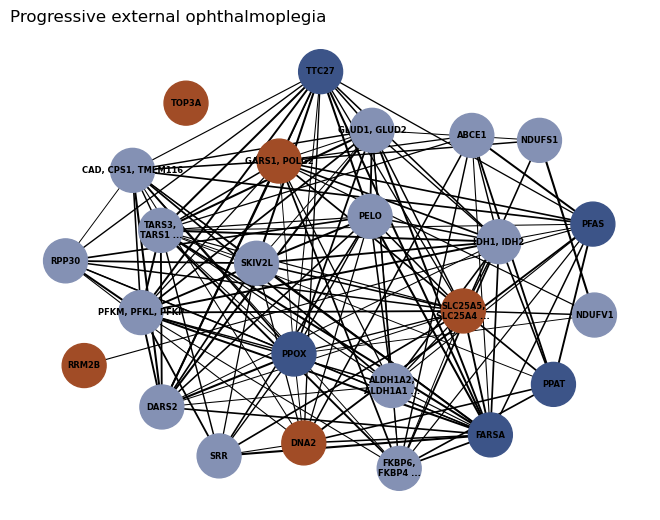

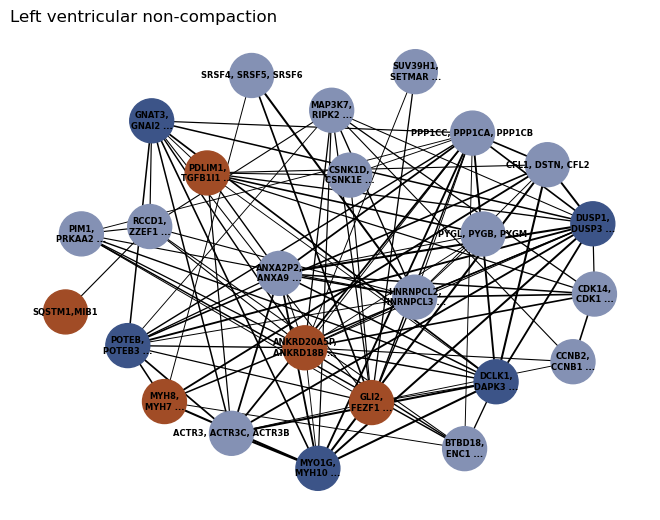

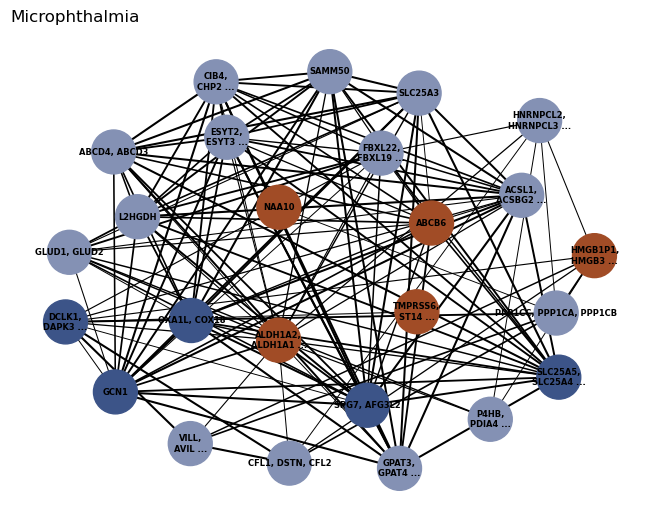

In [11]:
#for i in range(10):
for i in range(len(res)):
    inputs = res['input_nogs'][i].split(';')
    cands = res['top_hits'][i].split(';')
    top5 = cands[0:5]
    bot5 = cands[-15:]
    inputs_id_dict = get_geneid_dict(res, i)
    disease = res['disease'][i]
    all_nogs = cands+inputs
    all_ppis = [frozenset({i, j}) for i,j in list(combinations(all_nogs, 2))]
    ppi_nx['fs'] = [make_fset(i, drop=True) for i in ppi_nx['ID']]
    dis_nx = ppi_nx[ppi_nx['fs'].isin(all_ppis)].reset_index()
    
    protein_network = nx.Graph()
    # add nodes with color attribute (discrete variable)
    for i in all_nogs:
        color = [reds[1] if i in inputs else med_purple if i in top5 else light_purple][0]
        gene = map_id(i, cands_id_dict, inputs_id_dict)  
        protein_network.add_node(gene, color=color)

    # add edges with thickness attribute (continuous variable)
    for i in range(len(dis_nx)):
        p1 =  list(dis_nx['fs'][i])[0]
        gene1 = map_id(p1, cands_id_dict, inputs_id_dict)
        p2 =  list(dis_nx['fs'][i])[1]
        gene2 = map_id(p2, cands_id_dict, inputs_id_dict)
        weight = dis_nx['ppi_score'][i]
        protein_network.add_edge(gene1, gene2, thickness=weight*1.5)

    # extract node colors and edge thickness attributes
    node_colors = [protein_network.nodes[node]["color"] for node in protein_network.nodes()]
    edge_thickness = [protein_network.edges[edge]["thickness"] for edge in protein_network.edges()]

    # draw the network using NetworkX with custom attributes
    pos = nx.arf_layout(protein_network)
    nx.draw(protein_network, pos, with_labels=True, node_size=1000, font_size=6, font_weight="bold", node_color=node_colors, width=edge_thickness)

    # add title
    plt.title(disease, loc="left")
    
    # save figure
    dis_fmt = disease.replace(' ', '_')
    plt.savefig(f"{proj_dir}/figures/{dis_fmt}_network.png", dpi=300)
    plt.savefig(f"{proj_dir}/figures/{dis_fmt}_network.pdf", dpi=300)

    # show the plot
    plt.show()

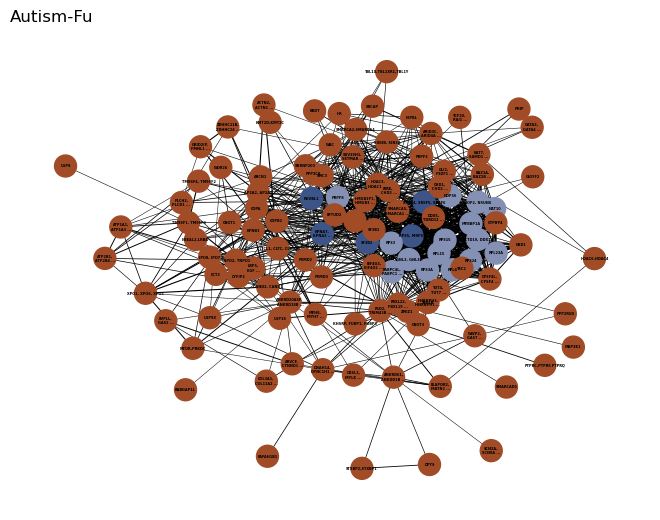

In [61]:
res_fu = res[res.disease == 'Autism-Fu']
inputs = res_fu['input_nogs'].to_list()[0].split(';')
genes = res_fu['gene_names'].to_list()[0].split(';')
genes = [fmt_gene_name(x) for x in genes]
inputs_id_dict = dict(zip(inputs, genes))
cands = res_fu['top_hits'].to_list()[0].split(';')
top5 = cands[0:5]
bot5 = cands[-15:]
disease = res_fu['disease'].to_list()[0]
all_nogs = cands+inputs
all_ppis = [frozenset({i, j}) for i,j in list(combinations(all_nogs, 2))]
ppi_nx['fs'] = [make_fset(i, drop=True) for i in ppi_nx['ID']]
dis_nx = ppi_nx[ppi_nx['fs'].isin(all_ppis)].reset_index()

protein_network = nx.Graph()
# add nodes with color attribute (discrete variable)
for i in all_nogs:
    color = [reds[1] if i in inputs else med_purple if i in top5 else light_purple][0]
    gene = map_id(i, cands_id_dict, inputs_id_dict)  
    protein_network.add_node(gene, color=color)

# add edges with thickness attribute (continuous variable)
for i in range(len(dis_nx)):
    p1 =  list(dis_nx['fs'][i])[0]
    gene1 = map_id(p1, cands_id_dict, inputs_id_dict)
    p2 =  list(dis_nx['fs'][i])[1]
    gene2 = map_id(p2, cands_id_dict, inputs_id_dict)
    weight = dis_nx['ppi_score'][i]
    protein_network.add_edge(gene1, gene2, thickness=weight*0.8)

# extract node colors and edge thickness attributes
node_colors = [protein_network.nodes[node]["color"] for node in protein_network.nodes()]
edge_thickness = [protein_network.edges[edge]["thickness"] for edge in protein_network.edges()]

# draw the network using NetworkX with custom attributes
#pos = nx.arf_layout(protein_network)
#pos = nx.circular_layout(protein_network)
pos = nx.kamada_kawai_layout(protein_network)
nx.draw(protein_network, pos, with_labels=True, node_size=250, font_size=2.5, font_weight="bold", node_color=node_colors, width=edge_thickness)

# add title
plt.title(disease, loc="left")

# save figure
dis_fmt = disease.replace(' ', '_')
plt.savefig(f"{proj_dir}/figures/{dis_fmt}_network.png", dpi=300)
plt.savefig(f"{proj_dir}/figures/{dis_fmt}_network.pdf", dpi=300)

# show the plot
plt.show()

In [40]:
help(nx.layout)

Help on module networkx.drawing.layout in networkx.drawing:

NAME
    networkx.drawing.layout

DESCRIPTION
    ******
    Layout
    ******
    
    Node positioning algorithms for graph drawing.
    
    For `random_layout()` the possible resulting shape
    is a square of side [0, scale] (default: [0, 1])
    Changing `center` shifts the layout by that amount.
    
    For the other layout routines, the extent is
    [center - scale, center + scale] (default: [-1, 1]).
    

FUNCTIONS
    arf_layout(G, pos=None, scaling=1, a=1.1, etol=1e-06, dt=0.001, max_iter=1000)
        Arf layout for networkx
        
        The attractive and repulsive forces (arf) layout [1]
        improves the spring layout in three ways. First, it
        prevents congestion of highly connected nodes due to
        strong forcing between nodes. Second, it utilizes the
        layout space more effectively by preventing large gaps
        that spring layout tends to create. Lastly, the arf
        layout re